In [7]:
%pylab inline
plt.style.use('dark_background')
pylab.rcParams['figure.figsize'] = (10.0, 6.0)

Populating the interactive namespace from numpy and matplotlib


# Trajectory functions

In [28]:
def point_to_point_traj(x1, x2, v1, v2, delta_t):
  t = np.linspace(0, delta_t, 100)  
  # the following is finding each coefficient for the spline
  a0 = x1
  a1 = v1
  a2 = (3*x2 - 3*x1 - 2*v1*delta_t - v2 * delta_t) / (delta_t**2)
  a3 = (2*x1 + (v1 + v2) * delta_t  - 2 * x2) / (delta_t**3)
  disp(a0);
  disp(a1);
  disp(a2);
  disp(a3);

  polynomial = a0 + a1 * t + a2 * t**2 + a3 * t**3
  derivative = a1 + 2*a2 * t + 3 * a3 * t**2
  # here we want to print the equation for the polynomial for use later
  print(a0.astype(str) + '+' + a1.astype(str) + '*(t-)+' + a2.astype(str)+'*(t-)**2+' + a3.astype(str)+'*(t-)**3')
  return polynomial, derivative


def piecewise2D (X,Y,Z, Vx, Vy, Vz, T):
    theta_x, theta_y, theta_z, dx, dy, dz = [], [], [], [], [], []
    
    fig = plt.figure()
    ax = plt.axes(projection='3d')
    for i in range(len(P)-1):          
        theta_xi, dxi = point_to_point_traj(X[i], X[i+1], Vx[i], Vx[i+1], T[i+1] - T[i])
        theta_yi, dyi = point_to_point_traj(Y[i], Y[i+1], Vy[i], Vy[i+1], T[i+1] - T[i])
        theta_zi, dzi = point_to_point_traj(Z[i], Z[i+1], Vz[i], Vz[i+1], T[i+1] - T[i])

        theta_x += theta_xi.tolist()
        theta_y += theta_yi.tolist()
        theta_z += theta_zi.tolist()
        dx += dxi.tolist()
        dy += dyi.tolist()
        dz += dzi.tolist()
        
        
        plot(theta_xi, theta_yi, theta_zi)
    return theta_x, theta_y, theta_z, dx, dy, dz

# Plotting functions

In [29]:
# Plotting
def plot_points():
    fig = plt.figure()
    ax = plt.axes(projection='3d')
    plot(X,Y,Z, '--')
    plot(X,Y,Z, 'o')
    quiver(X,Y,Z, Vx, Vy, Vz, color='r')
    
# Speed
def plot_speed():
    speed = np.sqrt(np.array(dx)**2 + np.array(dy)**2 + np.array(dz)**2)
    plot(speed)

# Example 1

In [44]:
##### Requirements for the trajectory

# Waypoints
p1 = [5.875, 9.05, 0.51]
p2 = [1.85, 2.675, 1.475]
p3 = [-3.775, 3.3, 1.95]
p4 = [-3.775, 3.3, 5.625]
p5 = [6.975, 1.2, 1.475]
p6 = [4.625, -6.85, 1.475]
p7 = [-9.125, -8, 1.475]

# Velocities
v1 = [-0.2, -0.5, 0.02]
v2 = [-0.5, 0, 0.05]
v3 = [0, -1, 0.5]
v4 = [0,2,0.5]
v5 = [2,-1,0]
v6 = [-1, -2, 0]
v7 = [-2, 0.3, 0]


# Time
t1 = 0
t2 = 22
t3 = 35
t4 = 49
t5 = 60
t6 = 72
t7 = 83

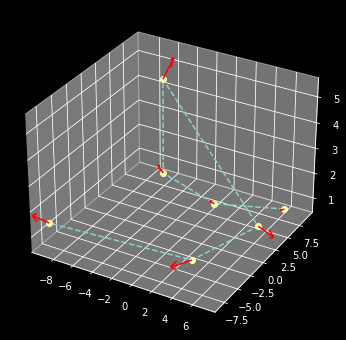

In [45]:
# Convert the initial conditions to a vector form
P = np.vstack((p1, p2, p3, p4, p5, p6, p7))
V = np.vstack((v1, v2, v3, v4, v5, v6, v7))
T = [t1, t2, t3, t4, t5, t6, t7]

X, Y, Z = P[:,0], P[:,1], P[:,2]
Vx, Vy, Vz = V[:,0], V[:,1], V[:,2]

plot_points()

5.875
-0.2
0.015960743801652896
-0.0006902704733283244
5.875+-0.2*(t-)+0.015960743801652896*(t-)**2+-0.0006902704733283244*(t-)**3
9.05
-0.5
0.0059400826446280915
0.0001643501126972203
9.05+-0.5*(t-)+0.0059400826446280915*(t-)**2+0.0001643501126972203*(t-)**3
0.51
0.02
0.001890495867768596
-3.662659654395193e-05
0.51+0.02*(t-)+0.001890495867768596*(t-)**2+-3.662659654395193e-05*(t-)**3
1.85
-0.5
-0.022928994082840236
0.002162039144287665
1.85+-0.5*(t-)+-0.022928994082840236*(t-)**2+0.002162039144287665*(t-)**3
2.675
0.0
0.08801775147928995
-0.006486117432862995
2.675+0.0*(t-)+0.08801775147928995*(t-)**2+-0.006486117432862995*(t-)**3
1.475
0.05
-0.037721893491124266
0.002822030040964953
1.475+0.05*(t-)+-0.037721893491124266*(t-)**2+0.002822030040964953*(t-)**3
-3.775
0.0
0.0
0.0
-3.775+0.0*(t-)+0.0*(t-)**2+0.0*(t-)**3
3.3
-1.0
0.0
0.005102040816326531
3.3+-1.0*(t-)+0.0*(t-)**2+0.005102040816326531*(t-)**3
1.95
0.5
-0.05089285714285714
0.0024234693877551016
1.95+0.5*(t-)+-0.0508928571428

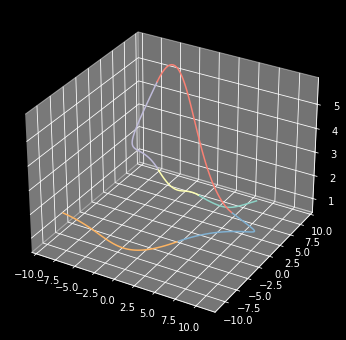

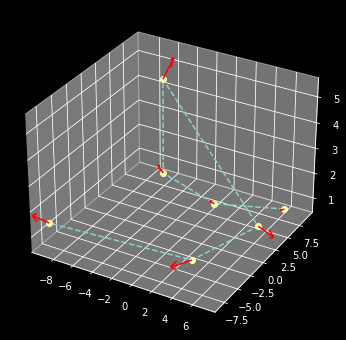

In [46]:
# Plot the trajectory that passes trhough the desired waypoints
theta_x, theta_y, theta_z, dx, dy, dz = piecewise2D(X,Y,Z, Vx, Vy, Vz, T)
plot_points()

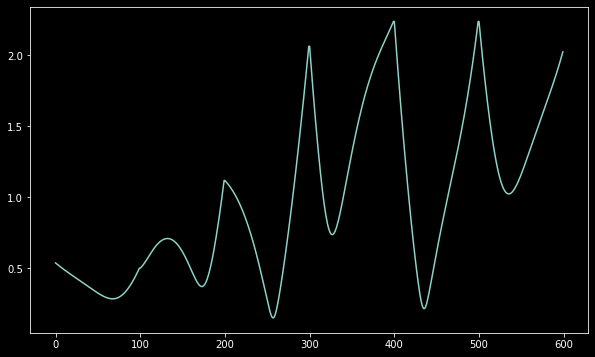

In [47]:
# Plot speed
plot_speed()

# Example 2

ValueError: operands could not be broadcast together with remapped shapes [original->remapped]: (7,) and requested shape (10,)

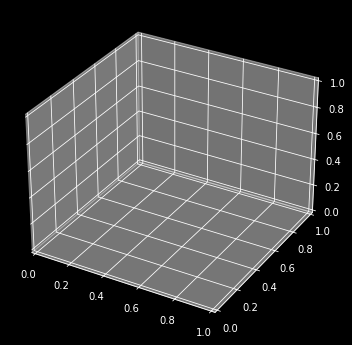

In [48]:
##### Requirements for the trajectory

# Waypoints
p1 = [-5,-7]
p2 = [10, -7]
p3 = [10,-3]
p4 = [0,-3]
p5 = [0,7]
p6 = [3,7]
p7 = [3,-3]
p8 = [7,-3]
p9 = [7,10]
p10 = [9,10]

# Velocities
v1 = [1,0]
v2 = [0,1]
v3 = [-1,0]
v4 = [0,1]
v5 = [1,0]
v6 = [0,-1]
v7 = [1,0]
v8 = [0,1]
v9 = [1,0]
v10 = [0,0]

# Time
t1 = 0
t2 = t1 + 5
t3 = t2 + 1
t4 = t3 + 4
t5 = t4 + 3
t6 = t5 + 2
t7 = t6 + 3
t8 = t7 + 2
t9 = t8 + 4
t10 = t9 + 1


# Grouping
P = np.vstack((p1, p2, p3, p4, p5, p6, p7, p8, p9, p10))
V = np.vstack((v1, v2, v3, v4, v5, v6, v7, v8, v9, v10))
T = [t1, t2, t3, t4, t5, t6, t7, t8, t9, t10]

X, Y = P[:,0], P[:,1]
Vx, Vy = V[:,0], V[:,1]

# Plotting
plot_points()
show()

# Piecewise function
theta_x, theta_y, theta_z, dx, dy, dz = piecewise2D(X,Y, Vx, Vy, T)

# Plotting
quiver(X,Y, Vx, Vy, color='r')  #

show()
plot_speed()

# Moving the point in time
Be sure that you have JSAnimation installed. If not pip install JSAnimation

Animation size has reached 20980285 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


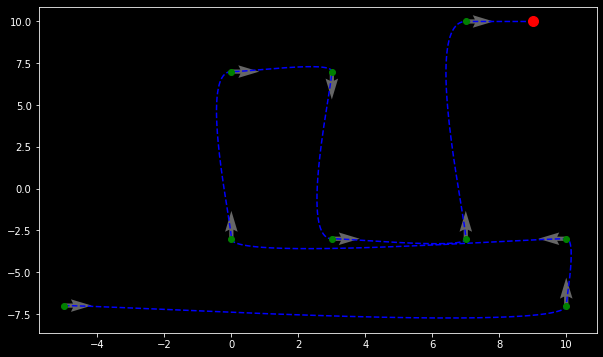

In [16]:
import matplotlib.pyplot as plt
from matplotlib import animation
from JSAnimation import IPython_display    
from IPython.display import HTML
    


fig, ax = plt.subplots()

def animate(t):
    ax.clear()
    
    # Path
    ax.plot(theta_x, theta_y, 'b--')
    
    # Initial conditions
    ax.plot(X,Y, 'go')
    ax.quiver(X,Y, Vx, Vy, color='0.4', scale=20)
        
    # Dynamic position
    ax.plot(theta_x[t], theta_y[t], 'ro', markersize=10)
       
    # Velocity vector
    ax.quiver([theta_x[t]], [theta_y[t]], [dx[t]], [dy[t]], color='r', units='xy', scale=10/np.linalg.norm([theta_x[t], theta_y[t]]))
    

anim = animation.FuncAnimation(fig, animate, frames=int(len(theta_x)/1), interval=25)


HTML(anim.to_jshtml())

In [17]:
# Export the movie to mp4
Be sure that you have the ffmpeg codec installed (sudo apt-get install ffmpeg).

SyntaxError: invalid syntax (<ipython-input-17-a9a38e48c230>, line 2)

In [ ]:
anim.save('trajectory2.mp4', dpi=300)